# Networks of persons in relation to organisations

Network analysis

* Pajek book chapter ...

[!!! provisoire, à compléter avec bibliographie]

In [1]:
### Librairie à installer dans l'environnement conda (si on exécute en local)
# qui sera choisi pour exécuter le carnet
from SPARQLWrapper import SPARQLWrapper, JSON, TURTLE, XML, RDFXML
import pandas as pd

import networkx as nx
from networkx.algorithms import bipartite

import matplotlib.pyplot as plt
import numpy as np
import math
import os

In [2]:
### Librairies déjà installées avec Python
import pprint
import csv

import sqlite3 as sql

import time
import datetime
from dateutil import parser


from shutil import copyfile


In [3]:
### Importer un module de fonctions crées ad hoc
##  ATTENTION : le fichier 'sparql_functions.py' doit se trouver 
#   dans un dossier qui se situe dans le chemin ('path') de recherche
#   vu par le présent carnet Jupyter afin que
#   l'importation fonctionne correctement

import sys
from importlib import reload

# Add parent directory to the path
sys.path.insert(0, '..')

### If you want to add the parent-parent directory,
sys.path.insert(0, '../..')


import sparql_functions as spqf
import network_analysis_functions as naf

In [ ]:
print(reload(naf))  

## Get the data from the triplestore

...  [compléter]


In [ ]:
## define SPARQL enpoint
endpoint = "https://ag16gm9pr0meths2.allegrograph.cloud/repositories/astronomers"

In [ ]:
query = """

PREFIX franzOption_defaultDatasetBehavior: <franz:rdf>
PREFIX wd: <http://www.wikidata.org/entity/>
PREFIX wdt: <http://www.wikidata.org/prop/direct/>
PREFIX rdf: <http://www.w3.org/1999/02/22-rdf-syntax-ns#>
PREFIX rdfs: <http://www.w3.org/2000/01/rdf-schema#>
PREFIX crm: <http://www.cidoc-crm.org/cidoc-crm/>
PREFIX wikibase: <http://wikiba.se/ontology#>
PREFIX bd: <http://www.bigdata.com/rdf#>


SELECT ?person (MIN(?pLabel) AS ?personLabel)
        (MIN(?birthYear) AS ?birthYear)
        ?relationship 
        ?organisation (MIN(?oLabel) AS ?organisationLabel)
        (COUNT(*) as ?n) 
        (GROUP_CONCAT(DISTINCT ?groupTypeLabel; separator=" | ") AS ?groupTypes) 
        #(GROUP_CONCAT(DISTINCT ?countryLabel; separator=" | ") AS ?countries) 

WHERE {
        GRAPH <https://github.com/Sciences-historiques-numeriques/astronomers/blob/main/graphs/wikidata-imported-data.md>
        {
        {?person a wd:Q5;
           rdfs:label ?pLabel;
           wdt:P569 ?birthYear.
        }


        {?person wdt:P108 ?organisation.
        BIND('employment' AS ?relationship)
        }   
        UNION
        {?person wdt:P463 ?organisation.
        BIND('membership' AS ?relationship)
        }   
        UNION
        {?person wdt:P69 ?organisation.
        BIND('education' AS ?relationship)
        }  
        ?organisation rdfs:label ?oLabel;
                 wdt:P31 ?groupType.
        ?groupType rdfs:label ?groupTypeLabel         
        
        # OPTIONAL {
        #    ?organisation wdt:P17 ?country.
        #    ?country rdfs:label ?countryLabel.
        # }

         }        



    }

GROUP BY ?person ?relationship ?organisation   
ORDER by ?person 
"""

In [ ]:
### Executer la requête avec les fonctions de la librairie locale
try:
    qr = spqf.get_json_sparql_result(endpoint,query)
    out = [l for l in spqf.sparql_result_to_list(qr)]
    print(len(out))
    pprint.pprint(out[100:103])
except Exception as e:
    print(e)    


## Inspect the data


In [ ]:
### Créer un DataFrame à partir du résultat
df_p = pd.DataFrame(out)
df_p.columns = ['uriPer', 'labelPer', 'birthYear', 'relaType', 'uriOrg', 'labelOrg', 'nTypes',
                'typesO']
print('Number: ',len(df_p))
df_p.iloc[10:13,:]


### Distribution of relationships in relation to birthYears

In [ ]:
l_50 = list(range(1751, 2051, 50))
print(l_50)

In [ ]:
lc = [1751, 1801, 1851, 1901, 1921, 1941, 1961, 1981, 2001]

In [ ]:
### convert birthYear to integer
df_p.birthYear = df_p.birthYear.apply(lambda x : int(x))

In [ ]:
### fonction pd.cut : https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.cut.html
# On ajoute une nouvelle colonne qui contient la période sur la base de la liste précédente
# et de la valeur de l'année
df_p['periods'] = pd.cut(df_p['birthYear'], lc, right=False)

### Transformer le code ajouté pour qu'il soit plus lisible
# noter qu'on a arrondi les valeurs
df_p['periods'] = df_p['periods'].apply(lambda x : str(int(x.left))+'-'+ str(int(x.right)-1))

# Inspection
df_p.head(3)

In [6]:
df_period = df_p.groupby(by='periods', observed=True).size()
print(df_period)

periods
1751-1800     2030
1801-1850     4128
1851-1900    10672
1901-1920    10585
1921-1940    18688
1941-1960    19368
1961-1980    10344
1981-2000     2414
dtype: int64


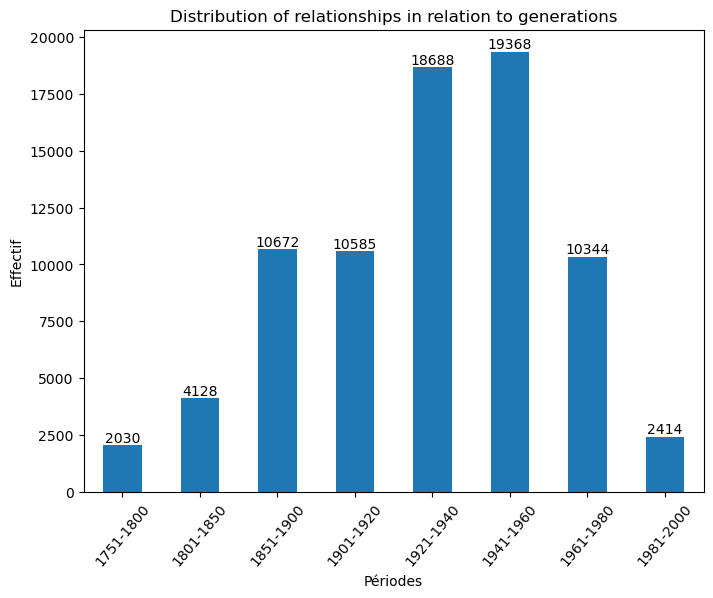

In [279]:
ax = df_period.plot(kind='bar',rot=50, fontsize=10, figsize=(8,6))
ax.bar_label(ax.containers[-1], size=10)
plt.ylabel('Effectif')
plt.xlabel('Périodes')
plt.title('Distribution of relationships in relation to generations')
plt.show()

#### Save dataframe to CSV

In [ ]:
file_add = 'data/persons_organisations.csv'
df_p.to_csv(file_add, index=False, sep=',', quotechar='"')

In [10]:
### load from CSV

file_add = 'data/persons_organisations.csv'
df_p=pd.read_csv(file_add)
print(len(df_p))
df_p.head(2)

78229


,uriPer,labelPer,birthYear,relaType,uriOrg,labelOrg,nTypes,typesO,periodes,listTypesO,listTokensTypesO,BeginY,EndY,periods
0,http://www.wikidata.org/entity/Q1000193,Hans Elsässer,1929,membership,http://www.wikidata.org/entity/Q833738,Heidelberg Academy for Sciences and Humanities,2,academy of sciences | building,1921-1940,"['academy of sciences', 'building']","['academy', 'building', 'sciences']",NaN,NaN,1921-1940
1,http://www.wikidata.org/entity/Q1000193,Hans Elsässer,1929,education,http://www.wikidata.org/entity/Q153978,University of Tübingen,6,public university | comprehensive university |...,1921-1940,"['comprehensive university', 'open-access publ...","['comprehensive', 'excellence', 'open-access',...",1947.0,1958.0,1921-1940


### Types of organisations

In [ ]:
### convert birthYear to integer
df_p['listTypesO'] = df_p.typesO.apply(lambda x : sorted([e.strip().lower() for e in x.split('|')]))

# decompose in the tokens, unique
df_p['listTokensTypesO'] = df_p.listTypesO.apply(lambda x : sorted(list(set([e for e in (' '.join(x)).split(' ') if len(e) > 2]))))

pprint.pprint(df_p.head().listTypesO.to_list())
print('-----')
pprint.pprint(df_p.head().listTokensTypesO.to_list())

In [ ]:
ll = df_p.listTypesO.to_list()
print(len(ll))
print(ll[:3])

In [ ]:
llj = [' | '.join(b) for b in ll]
print(len(llj))
print(llj[:3])

In [ ]:
ls = pd.Series(llj)
ltg = pd.DataFrame(ls.groupby(by=ls).size().sort_values(ascending=False))
ltg.reset_index(inplace=True)
ltg.columns=['orgType_group', 'effectif']
ltg.head()


In [ ]:
csv_file='files/network_organisations_types_groups.csv'
ltg.to_csv(csv_file)
print(ltg.iloc[30:40])

#### Wikidata 'instance of'

In [ ]:
ll = df_p.listTypesO.to_list()
print(len(ll))

In [ ]:
ltt = [a for b in df_p.listTypesO.to_list() for a in b]
print(len(ltt))

In [ ]:
ls = pd.Series(ltt)


In [ ]:
ltg = pd.DataFrame(ls.groupby(by=ls).size().sort_values(ascending=False))
ltg.reset_index(inplace=True)
ltg.columns=['organisation', 'effectif']
ltg.head()


In [ ]:
csv_file='files/network_organisations_types.csv'
ltg.to_csv(csv_file)
print(ltg.iloc[30:40])

#### Wikidata tokens of 'instance of'

In [ ]:
ll = df_p.listTokensTypesO.to_list()
print(len(ll))

In [ ]:
ltt = [a for b in df_p.listTokensTypesO.to_list() for a in b]
print(len(ltt))

In [ ]:
ls = pd.Series(ltt)
ltg = pd.DataFrame(ls.groupby(by=ls).size().sort_values(ascending=False))
ltg.reset_index(inplace=True)
ltg.columns=['token', 'effectif']
ltg.head()


In [ ]:
csv_file='files/network_organisations_types_tokens.csv'
ltg.to_csv(csv_file)
print(ltg.iloc[30:40])

### Add education period

In [15]:
### Add constructed education period
df_p['BeginY'] = df_p[df_p.relaType=='education'].birthYear.apply(lambda x : x + 18)
df_p['EndY'] = df_p[df_p.relaType=='education'].birthYear.apply(lambda x : x + 29)
df_p.iloc[5:9]

,uriPer,labelPer,birthYear,relaType,uriOrg,labelOrg,nTypes,typesO,periodes,listTypesO,listTokensTypesO,BeginY,EndY,periods
5,http://www.wikidata.org/entity/Q1000934,Charles Christian Lauritsen,1892,membership,http://www.wikidata.org/entity/Q1636237,Royal Danish Academy of Sciences and Letters,1,academy of sciences,1851-1900,['academy of sciences'],"['academy', 'sciences']",NaN,NaN,1851-1900
6,http://www.wikidata.org/entity/Q1000934,Charles Christian Lauritsen,1892,education,http://www.wikidata.org/entity/Q3436286,Odense University,1,university,1851-1900,['university'],['university'],1910.0,1921.0,1851-1900
7,http://www.wikidata.org/entity/Q100153910,Frank J. Blatt,1924,employment,http://www.wikidata.org/entity/Q1499258,United States Naval Research Laboratory,2,research institute | military unit,1921-1940,"['military unit', 'research institute']","['institute', 'military', 'research', 'unit']",NaN,NaN,1921-1940
8,http://www.wikidata.org/entity/Q100153910,Frank J. Blatt,1924,employment,http://www.wikidata.org/entity/Q1410332,National University of Lesotho,1,public university,1921-1940,['public university'],"['public', 'university']",NaN,NaN,1921-1940


## Create graph for a given period


This is a graph of type 'bipartite', cf. :

https://networkx.org/documentation/stable/reference/algorithms/bipartite.html


We do not use here the functions related to this kind of graph

In [21]:
df_p_1901 = df_p[df_p.periods=='1901-1920'].copy(deep=True)
#pprint.pprint(df_p_1901.head(2).to_dict(orient='records'))

df_p_1961 = df_p[df_p.periods=='1961-1980'].copy(deep=True)
#pprint.pprint(df_p_1961.head(2).to_dict(orient='records'))

df_in_use = df_p_1901


In [18]:
## Provide the data in the format 
# required by Networkx

l = [tuple(
    (e['uriPer'], e['uriOrg'],
     {'relaType':e['relaType']}
     )) 
     for e in df_in_use.to_dict(orient='records')]
print(len(l))

10585


In [19]:
bip_g = nx.Graph()

bip_g.add_edges_from(l)
naf.basic_graph_properties(bip_g)

{'is_multigraph': False,
 'is_directed': False,
 'number_of_nodes': 5176,
 'number_of_edges': 9910,
 '------': '------',
 'is connected': False,
 'components': 100,
 'density': 0.0007399442988449104}


In [20]:
le = list(bip_g.edges.data())
# print([e[2]['relaType'] for e in le][:3]) 
srt = pd.Series([e[2]['relaType'] for e in le])
print(srt.groupby(by=srt).size())

education     3726
employment    3798
membership    2386
dtype: int64


#### Add metadata to nodes

In [22]:
df_p1 = df_in_use[['uriPer','labelPer','birthYear']]
df_p1 = df_p1.drop_duplicates()
df_p1.columns=['uri', 'label', 'birthYear']
df_p1.head(2)

,uri,label,birthYear
60,http://www.wikidata.org/entity/Q100231,Walter Weizel,1901
80,http://www.wikidata.org/entity/Q100281884,Hubert M. James,1908


In [23]:
### Add data to nodes

## Prepare data to import
l = dict([(e['uri'],
     {'label':e['label'], 'birthYear':e['birthYear'],
      'bipartite':0}
     ) for e in df_p1.to_dict(orient='records')])
# print(str(l)[:200])

In [25]:

## Add attributes
nx.set_node_attributes(bip_g, l)
pprint.pprint(list(bip_g.nodes.data())[:3])


[('http://www.wikidata.org/entity/Q100231',
  {'bipartite': 0, 'birthYear': 1901, 'label': 'Walter Weizel'}),
 ('http://www.wikidata.org/entity/Q309988', {}),
 ('http://www.wikidata.org/entity/Q100281884',
  {'bipartite': 0, 'birthYear': 1908, 'label': 'Hubert M. James'})]


In [27]:
df_p2 = df_in_use[['uriOrg','labelOrg']]
df_p2 = df_p2.drop_duplicates()
df_p2.columns=['uri', 'label']
df_p2.head(2)

,uri,label
60,http://www.wikidata.org/entity/Q309988,Karlsruhe Institute of Technology
80,http://www.wikidata.org/entity/Q13371,Harvard University


In [28]:
### Add data to nodes

## Prepare data to import
l = dict([(e['uri'],
     {'label':e['label'],
      'bipartite':1}
     ) for e in df_p2.to_dict(orient='records')])
# print(str(l)[:200])

In [30]:

## Add attributes
nx.set_node_attributes(bip_g, l)
pprint.pprint(list(bip_g.nodes.data())[:3])

[('http://www.wikidata.org/entity/Q100231',
  {'bipartite': 0, 'birthYear': 1901, 'label': 'Walter Weizel'}),
 ('http://www.wikidata.org/entity/Q309988',
  {'bipartite': 1, 'label': 'Karlsruhe Institute of Technology'}),
 ('http://www.wikidata.org/entity/Q100281884',
  {'bipartite': 0, 'birthYear': 1908, 'label': 'Hubert M. James'})]


#### Partition 

Explore small partitions

In [280]:
### Créer à partir des sets de sommets qui forment les components un ensemble de sousgraphes
# Ces ensemble de sous-graphes est stocké dans la liste S
S = [bip_g.subgraph(c).copy() for c in nx.connected_components(bip_g)]

### i correspond à la position de la composante dans la liste S, len(s.nodes) à l'effectif des sommets
ln = sorted([[i,len(s.nodes)] for i,s in enumerate(S)], key = lambda row: row[1], reverse=True)
print(ln[:5])

[[0, 4946], [12, 6], [15, 5], [43, 5], [22, 4]]


In [281]:
### 
li = [6, 12, 30]    # [12, 15, 43]
ll = [list(S[i[0]].nodes.data()) for i in ln if i[0] in li ]
pprint.pprint(ll[0][:2])

[('http://www.wikidata.org/entity/Q1126143',
  {'bipartite': 1, 'label': 'Society of Fighters for Freedom and Democracy'}),
 ('http://www.wikidata.org/entity/Q16614793',
  {'bipartite': 1, 'label': 'Q16614793'})]


In [282]:
li = li
u = nx.Graph()
for i in li:
    ## ajoute au graphe les composantes en utilisant
    # l'index ou position dans la liste de graphes 'S'
    u = nx.union(u, S[i])
print(bipartite.is_bipartite(u))   
naf.basic_graph_properties(u)

True
{'is_multigraph': False,
 'is_directed': False,
 'number_of_nodes': 10,
 'number_of_edges': 7,
 '------': '------',
 'is connected': False,
 'components': 3,
 'density': 0.15555555555555556}


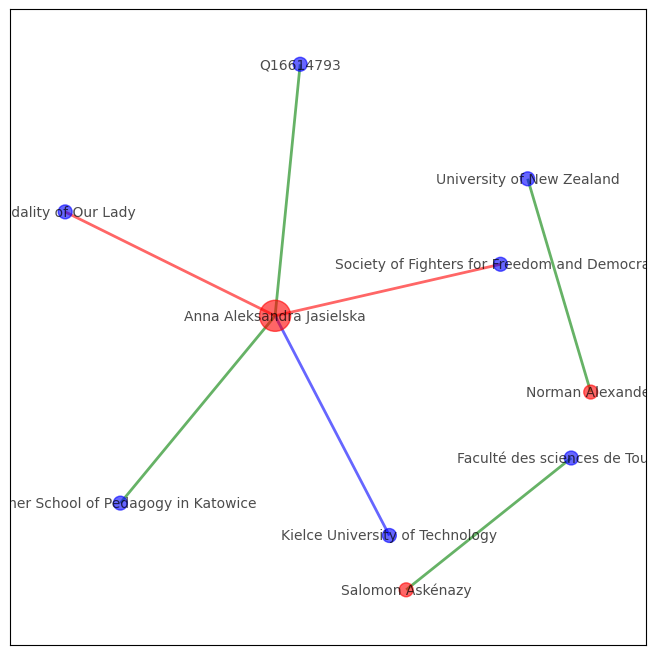

In [309]:
### Plot the graph

g = u

n_size = np.log(np.sqrt(nx.number_of_nodes(g)))* 20 #*25

graph_layout = 'kamada_kawai'
n_k = 0.8
sc = 20

### Define the layout, i.e. the choice 
# of the algorithm for the representation of the graph.

if graph_layout == 'fruchterman_reingold':
    pos = nx.fruchterman_reingold_layout(g)
elif graph_layout == 'kamada_kawai':
    pos = nx.kamada_kawai_layout(g)
elif graph_layout == 'spring_layout':
    pos = nx.spring_layout(g, k = n_k, scale=sc)  
else:
    pos = nx.kamada_kawai_layout(g)

# https://networkx.org/documentation/stable/reference/drawing.html
plt.figure(figsize = (n_size,n_size))

node_size = [d[1]*100 for d in nx.degree(g)]
node_labels = dict([tuple(( n[0] , n[1]['label'] ))for n in g.nodes.data()])
node_colors = ['red' if n[1]['bipartite'] == 0 else 'blue' for n in g.nodes.data()]
edge_colors = ['blue' if n[2]['relaType'] == 'employment' 
               else 'red' if n[2]['relaType'] == 'membership' 
               else 'green' for n in g.edges.data()]


nx.draw_networkx_nodes(g, pos,  node_color=node_colors, node_size=node_size, alpha=0.6)
nx.draw_networkx_edges(g, pos, edge_color=edge_colors, width=2, alpha=0.6) # edgelist=ln, edge_color=c, 
nx.draw_networkx_labels(g, pos, labels=node_labels, alpha=0.7, font_size=10)

### On peut augmenter ou diminuer ce paramètre pour ajuster le graphe
plt.tight_layout(pad=60)
#plt.savefig('images/small_bipartite_component.svg')
plt.show()


#### Biggest component

In [41]:
li = [0]
u = nx.Graph()
for i in li:
    ## ajoute au graphe les composantes en utilisant
    # l'index ou position dans la liste de graphes 'S'
    u = nx.union(u, S[i])
print(bipartite.is_bipartite(u))   
naf.basic_graph_properties(u)

True
{'is_multigraph': False,
 'is_directed': False,
 'number_of_nodes': 4946,
 'number_of_edges': 9779,
 '------': '------',
 'is connected': True,
 'components': 1,
 'density': 0.0007996575349466861}


In [45]:
### Add degree centrality to nodes
degree = dict([(d[0], {'degree': d[1]}) for d in nx.degree(u)])
nx.set_node_attributes(u, degree)
pprint.pprint(list(u.nodes.data())[:2])

[('http://www.wikidata.org/entity/Q100231',
  {'bipartite': 0, 'birthYear': 1901, 'degree': 1, 'label': 'Walter Weizel'}),
 ('http://www.wikidata.org/entity/Q309988',
  {'bipartite': 1, 'degree': 9, 'label': 'Karlsruhe Institute of Technology'})]


In [49]:
### Add eivenvalue to nodes
eigenvector = nx.eigenvector_centrality(u, max_iter=300)
nx.set_node_attributes(u, eigenvector, 'eigenvector')
pprint.pprint(list(u.nodes.data())[1:3])

[('http://www.wikidata.org/entity/Q309988',
  {'bipartite': 1,
   'degree': 9,
   'eigenvector': 0.0005316171471272166,
   'label': 'Karlsruhe Institute of Technology'}),
 ('http://www.wikidata.org/entity/Q100281884',
  {'bipartite': 0,
   'birthYear': 1908,
   'degree': 3,
   'eigenvector': 0.003806964033678901,
   'label': 'Hubert M. James'})]


In [238]:
### A k-core is a maximal subgraph that contains nodes of degree k or more.
# https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.core.core_number.html#networkx.algorithms.core.core_number

cn = nx.core_number(u)
print(str(cn)[:150])

{'http://www.wikidata.org/entity/Q100231': 1, 'http://www.wikidata.org/entity/Q309988': 3, 'http://www.wikidata.org/entity/Q100281884': 2, 'http://www


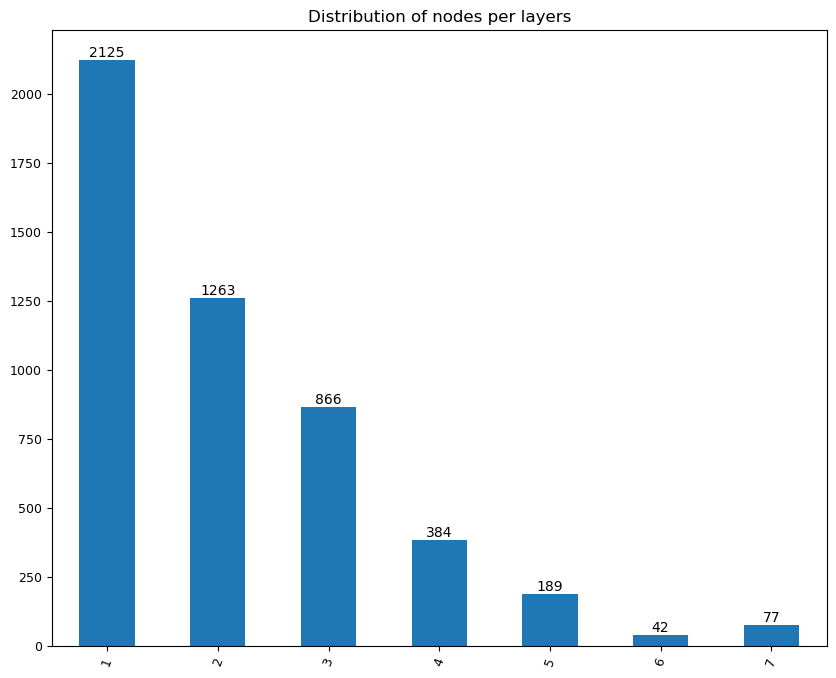

In [50]:
### Distribution of nodes per core layer
l = [v for k,v in cn.items()]
ls = pd.Series(l)
grouped = ls.groupby(ls).size()


ax = grouped.plot.bar(stacked=True, rot=70, fontsize=9, figsize=(10,8))
plt.title('Distribution of nodes per layers')

## https://stackoverflow.com/questions/71320380/add-only-the-total-values-on-top-of-stacked-bars
ax.bar_label(ax.containers[-1])

plt.show()


In [239]:
ln = [ k  for k,v in cn.items()  if v > 6]
print(ln[:2])

['http://www.wikidata.org/entity/Q13371', 'http://www.wikidata.org/entity/Q49088']


In [240]:
SG = u.subgraph(ln)
naf.basic_graph_properties(SG)
pprint.pprint(list(SG.nodes.data())[:2])

{'is_multigraph': False,
 'is_directed': False,
 'number_of_nodes': 77,
 'number_of_edges': 398,
 '------': '------',
 'is connected': True,
 'components': 1,
 'density': 0.13602187286397813}
[('http://www.wikidata.org/entity/Q431503',
  {'bipartite': 0,
   'birthYear': 1914,
   'degree': 14,
   'eigenvector': 0.059199605641825824,
   'label': 'Lyman Spitzer'}),
 ('http://www.wikidata.org/entity/Q949',
  {'bipartite': 0,
   'birthYear': 1908,
   'degree': 13,
   'eigenvector': 0.059738802837736846,
   'label': 'John Bardeen'})]


count    119.000000
mean      10.789916
std       10.056513
min        6.000000
25%        7.000000
50%        8.000000
75%       10.000000
max       76.000000
dtype: float64


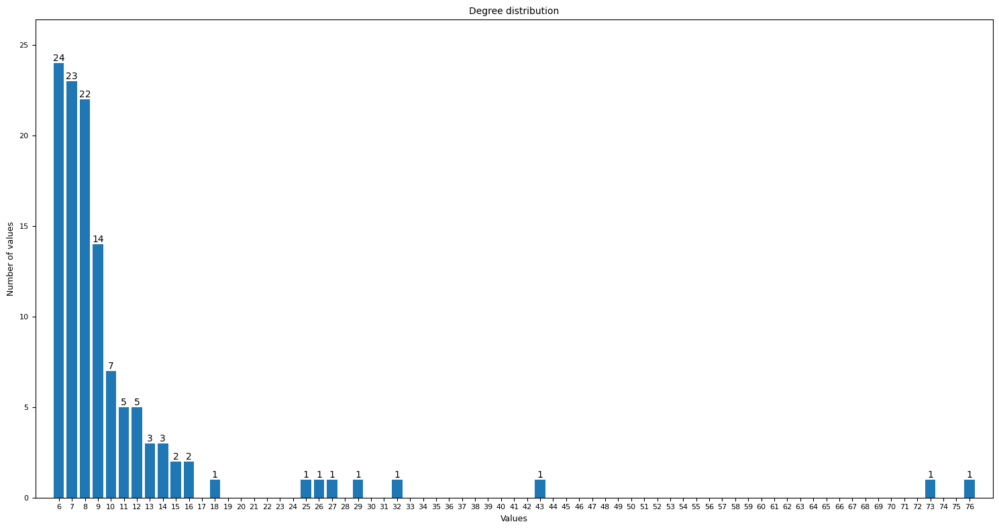

In [57]:
d = [d[1] for d in nx.degree(SG)]
naf.describe_plot_integers_distribution(d, 15,8,'Degree distribution')

In [241]:
### 

g = SG

n_size = np.log(np.sqrt(nx.number_of_nodes(g)))* 50 #*25

graph_layout = 'spring_layout'
n_k = 0.5
sc = 0.02

### Define the layout, i.e. the choice 
# of the algorithm for the representation of the graph.

if graph_layout == 'fruchterman_reingold':
    pos = nx.fruchterman_reingold_layout(g)
elif graph_layout == 'kamada_kawai':
    pos = nx.kamada_kawai_layout(g)
elif graph_layout == 'spring_layout':
    pos = nx.spring_layout(g, k = n_k, scale=sc)  
else:
    pos = nx.kamada_kawai_layout(g)




# https://networkx.org/documentation/stable/reference/drawing.html
plt.figure(figsize = (n_size,n_size))



## on définit ici l'algorythme avec lequel le traphe sera représenté

# node_size = [d[1]*100 for d in nx.degree(g)]
node_size = [d[1]*10000 for d in nx.eigenvector_centrality(g).items()]
#print(node_size)

#dict([tuple(( n[0] , n[1]['label'] ))for n in u.nodes.data()])
node_labels =  dict(((u), 
                    str(d['label']))
                    for u, d in g.nodes(data=True))

node_colors = ['red' if n[1]['bipartite'] == 0 else 'blue' for n in g.nodes.data()]

### On représente successivement les différentes sommets et arêtes,
# puis on ajoute les labels
nx.draw_networkx_nodes(g, pos,  node_color=node_colors, node_size=node_size, alpha=0.2)
nx.draw_networkx_edges(g, pos, alpha=0.1) # edgelist=ln, edge_color=c, 
nx.draw_networkx_labels(g, pos, labels=node_labels, alpha=0.8, font_size=20)

### On peut augmenter ou diminuer ce paramètre pour ajuster le graphe
plt.tight_layout(pad=50)
plt.savefig('images/biggest_bipartite_component_test.svg')
plt.close()
#plt.plot()

[1104.6815443913558, 1048.4697293698077, 3615.4749185991514, 758.635681063322, 939.1271223320828, 895.7912989959656, 1167.6537366621187, 992.1635857332129, 843.8778500747461, 1441.3496586446554, 879.5209053634464, 774.592467303137, 1029.6100487327024, 1011.9829014806554, 1038.9363928167907, 738.1882119195053, 839.8349145263761, 794.1342054234246, 1020.4491191060604, 1238.6092302745963, 1211.7091101158292, 733.0232526523258, 1052.1006836808626, 948.4507096766675, 914.1883438791679, 1042.4166135907658, 604.0715264820916, 639.470089831248, 972.9524803270323, 752.0255282524336, 1716.9597519067613, 955.3439779237756, 1093.6393315090515, 915.8224543037528, 778.570431441192, 1024.4661086891867, 1119.6109687093349, 1250.496571631695, 1089.664831639815, 1017.3131020951662, 1185.7970191227523, 519.4541210335054, 1291.497552488825, 601.3250657371526, 856.1374766215906, 974.5281778882454, 2438.5629623835466, 887.2732736521483, 612.611309797781, 921.2383799107511, 907.4210519686309, 1012.7355356493

#### Explore the degree centrality and eigenvector

In [242]:
export = pd.DataFrame(u.nodes.data(), columns = ['id', 'attributes'])
attributes = pd.json_normalize(export.attributes)

export = export.join(pd.json_normalize(export.attributes)).set_index('id')
export.drop(columns=['attributes'], inplace=True)
round(attributes, 3)
export.head(2)
#pprint.pprint(list(nd[:3]))

,label,birthYear,bipartite,degree,eigenvector
id,,,,,
http://www.wikidata.org/entity/Q100231,Walter Weizel,1901.0,0,1,0.000022
http://www.wikidata.org/entity/Q309988,Karlsruhe Institute of Technology,NaN,1,9,0.000532


In [243]:
### Most frequent persons/organisations by degree or eigenvector (replace in the sort clause !)
export.sort_values(by='eigenvector', ascending=False)[['label', 'bipartite', 'degree', 'eigenvector']].iloc[:20]

,label,bipartite,degree,eigenvector
id,,,,
http://www.wikidata.org/entity/Q270794,National Academy of Sciences,1,257,0.416168
http://www.wikidata.org/entity/Q463303,American Academy of Arts and Sciences,1,247,0.413192
http://www.wikidata.org/entity/Q123885,Royal Society,1,168,0.174841
http://www.wikidata.org/entity/Q2370801,Academy of Sciences of the USSR,1,157,0.097034
http://www.wikidata.org/entity/Q543804,German Academy of Sciences Leopoldina,1,90,0.093938
http://www.wikidata.org/entity/Q466113,American Physical Society,1,58,0.090571
http://www.wikidata.org/entity/Q49108,Massachusetts Institute of Technology,1,112,0.090084
http://www.wikidata.org/entity/Q168756,"University of California, Berkeley",1,108,0.088938
http://www.wikidata.org/entity/Q13371,Harvard University,1,110,0.083683


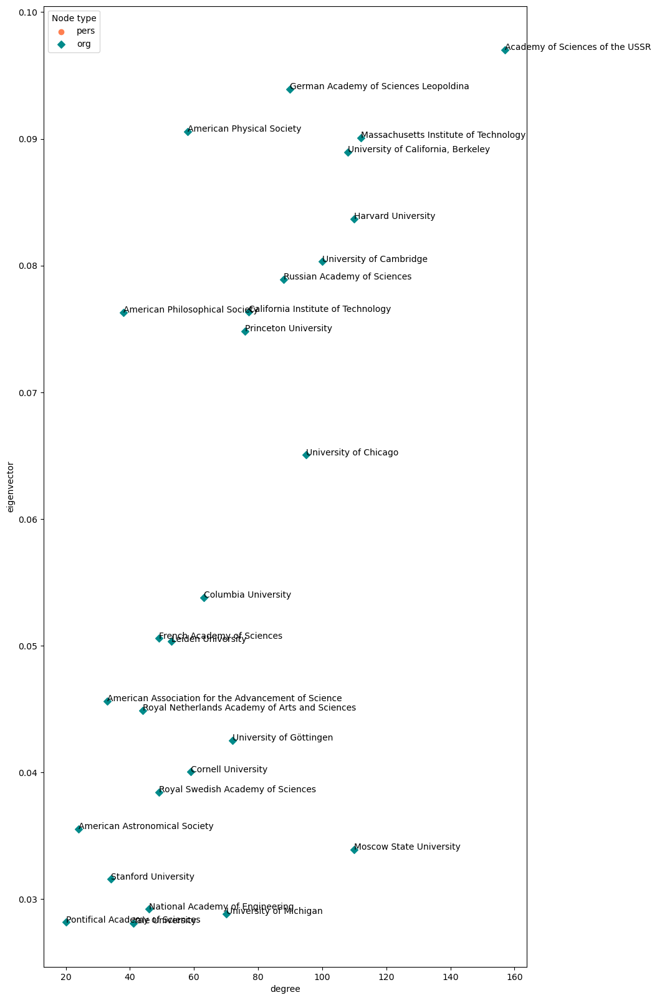

In [247]:
### https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.scatter.html
# Different colors per class : https://vitalflux.com/python-scatter-plot-different-classes/
# Legend : https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.legend.html
# Labels : https://stackoverflow.com/questions/14432557/matplotlib-scatter-plot-with-different-text-at-each-data-point


### Please note the filter ! 0 : persons, 1 : organisations
exp = export[export.bipartite==1].sort_values(by='eigenvector', ascending=False).iloc[3:30,:]

### Adapt image size and police
plt.figure(figsize=(10, 20))

## Please consider:
## https://how2matplotlib.com/matplotlib-scatter-label.html

plt.scatter(exp['degree'][(exp.bipartite == 0)], #  | (exp.Parti == 'MED')],
            exp['eigenvector'][(exp.bipartite == 0)], #  | (exp.Parti == 'MED')],
           marker='o',
           color='Coral',
           label='pers'
           )
plt.scatter(exp['degree'][(exp.bipartite == 1)], #  | (exp.Parti == 'MED')],
            exp['eigenvector'][(exp.bipartite == 1)], #  | (exp.Parti == 'MED')],
           marker='D',
           color='DarkCyan',
           label='org')
plt.xlabel('degree')
plt.ylabel('eigenvector')

for i,row in list(exp[['label', 'degree','eigenvector']].iterrows()):
    plt.annotate(row['label'],(row['degree'], row['eigenvector']))
plt.legend(title='Node type')
#plt.savefig('plots/sieges_eigenvector_20210526.jpg')
plt.show()

## Create graph of persons relationships during studies

In [84]:
print(list(df_p.columns))
df_p.head(2)

['uriPer', 'labelPer', 'birthYear', 'relaType', 'uriOrg', 'labelOrg', 'nTypes', 'typesO', 'periodes', 'listTypesO', 'listTokensTypesO', 'BeginY', 'EndY', 'periods']


,uriPer,labelPer,birthYear,relaType,uriOrg,labelOrg,nTypes,typesO,periodes,listTypesO,listTokensTypesO,BeginY,EndY,periods
0,http://www.wikidata.org/entity/Q1000193,Hans Elsässer,1929,membership,http://www.wikidata.org/entity/Q833738,Heidelberg Academy for Sciences and Humanities,2,academy of sciences | building,1921-1940,"['academy of sciences', 'building']","['academy', 'building', 'sciences']",NaN,NaN,1921-1940
1,http://www.wikidata.org/entity/Q1000193,Hans Elsässer,1929,education,http://www.wikidata.org/entity/Q153978,University of Tübingen,6,public university | comprehensive university |...,1921-1940,"['comprehensive university', 'open-access publ...","['comprehensive', 'excellence', 'open-access',...",1947.0,1958.0,1921-1940


### Prepare and create the graph

In [248]:
### Select the columns that will be used
df_sel = df_p[df_p.relaType=='education'][['uriPer','uriOrg', 'labelOrg', 'BeginY','EndY', 'periods']].copy(deep=True)
print(len(df_sel))

29294


In [ ]:
### Join on common organisation
merged = pd.merge(df_sel, df_sel, on=['uriOrg', 'labelOrg'])
print(len(merged))


3344010


In [ ]:
### Eliminate double rows
merged = merged[merged['uriPer_x'] < (merged['uriPer_y'])]
print(len(merged))

1657358


In [321]:
### Restrict time overlap (only 8 years overlap)
merged = merged[(merged['BeginY_y']+2 < merged['EndY_x']-2) & (merged['BeginY_x']+2 < merged['EndY_y']-2)]
print(len(merged))
merged = merged[['uriPer_x', 'uriPer_y', 'uriOrg', 'labelOrg', 'periods_x', 'BeginY_x', 'EndY_x',  'BeginY_y', 'EndY_y', 'periods_y']]



239517


In [322]:
print(len(merged))
print(list(merged.columns))
merged.head()

239517
['uriPer_x', 'uriPer_y', 'uriOrg', 'labelOrg', 'periods_x', 'BeginY_x', 'EndY_x', 'BeginY_y', 'EndY_y', 'periods_y']


,uriPer_x,uriPer_y,uriOrg,labelOrg,periods_x,BeginY_x,EndY_x,BeginY_y,EndY_y,periods_y
1,http://www.wikidata.org/entity/Q1000193,http://www.wikidata.org/entity/Q100212,http://www.wikidata.org/entity/Q153978,University of Tübingen,1921-1940,1947.0,1958.0,1951.0,1962.0,1921-1940
8,http://www.wikidata.org/entity/Q1000193,http://www.wikidata.org/entity/Q102239054,http://www.wikidata.org/entity/Q153978,University of Tübingen,1921-1940,1947.0,1958.0,1952.0,1963.0,1921-1940
18,http://www.wikidata.org/entity/Q1000193,http://www.wikidata.org/entity/Q102931598,http://www.wikidata.org/entity/Q153978,University of Tübingen,1921-1940,1947.0,1958.0,1942.0,1953.0,1921-1940
25,http://www.wikidata.org/entity/Q1000193,http://www.wikidata.org/entity/Q118363,http://www.wikidata.org/entity/Q153978,University of Tübingen,1921-1940,1947.0,1958.0,1949.0,1960.0,1921-1940
27,http://www.wikidata.org/entity/Q1000193,http://www.wikidata.org/entity/Q13422604,http://www.wikidata.org/entity/Q153978,University of Tübingen,1921-1940,1947.0,1958.0,1953.0,1964.0,1921-1940


In [ ]:
### Group by persons' pairs and count/aggregate organisations
## This is needed because the nx.add_edges_from() function applies
# a DISTINCT approach and information will be lost if two persons
# are related by more than one organisation 

gr_mer = merged.groupby(['uriPer_x', 'uriPer_y', 'periods_x', 'BeginY_x', 'EndY_x', 'BeginY_y', 'EndY_y', 'periods_y'], as_index = False)\
    .agg({'labelOrg': '|'.join, 'uriOrg': '|'.join})
gr_mer['number'] = gr_mer.labelOrg.apply(lambda x : len(x.split('|')))
print(len(gr_mer))


236467


In [ ]:
### change columns names
gr_mer.columns= ['uriPer_x', 'uriPer_y', 'periods_x', 'BeginY_x', 'EndY_x', 'BeginY_y', 'EndY_y', 'periods_y', 'orgs', 'uriOrgs', 'numberOrgs']

In [333]:
### change columns positions
gr_mer = gr_mer[['uriPer_x', 'uriPer_y', 'orgs', 'numberOrgs', 'uriOrgs', 'periods_x', 'BeginY_x', 'EndY_x', 'BeginY_y', 'EndY_y', 'periods_y']]
gr_mer.head(2)

,uriPer_x,uriPer_y,orgs,numberOrgs,uriOrgs,periods_x,BeginY_x,EndY_x,BeginY_y,EndY_y,periods_y
0,http://www.wikidata.org/entity/Q1000193,http://www.wikidata.org/entity/Q100212,University of Tübingen,1,http://www.wikidata.org/entity/Q153978,1921-1940,1947.0,1958.0,1951.0,1962.0,1921-1940
1,http://www.wikidata.org/entity/Q1000193,http://www.wikidata.org/entity/Q102239054,University of Tübingen,1,http://www.wikidata.org/entity/Q153978,1921-1940,1947.0,1958.0,1952.0,1963.0,1921-1940


In [341]:
### sort by multiple relationships
gr_mer[['uriPer_x','uriPer_y','orgs','numberOrgs']].sort_values(by='numberOrgs', ascending=False).iloc[:7]

,uriPer_x,uriPer_y,orgs,numberOrgs
117535,http://www.wikidata.org/entity/Q181369,http://www.wikidata.org/entity/Q183679,Tsinghua University|Peking University|National...,5
232196,http://www.wikidata.org/entity/Q742536,http://www.wikidata.org/entity/Q9095,University of Cambridge|Peterhouse|Edinburgh A...,4
29259,http://www.wikidata.org/entity/Q11168306,http://www.wikidata.org/entity/Q16090553,"University College of Science, Technology & Ag...",3
24400,http://www.wikidata.org/entity/Q109588,http://www.wikidata.org/entity/Q3170446,University of Paris|Lycée Louis-le-Grand|École...,3
127661,http://www.wikidata.org/entity/Q197941,http://www.wikidata.org/entity/Q202152,Massachusetts Institute of Technology|Stanford...,3
155184,http://www.wikidata.org/entity/Q24960980,http://www.wikidata.org/entity/Q507732,Harvard University|Massachusetts Institute of ...,3
183943,http://www.wikidata.org/entity/Q377898,http://www.wikidata.org/entity/Q45789,Presidency University|Hindu School|University ...,3


In [ ]:
### store multiple relationships in order to explore them
file_add = 'data/persons_education_rel_multiple.csv'
gr_mer[gr_mer.numberOrgs > 1].sort_values(by='numberOrgs', ascending=False).to_csv(file_add)

#### Example of connected persons



<img src="images/alg_gruff_example_chinese_connected_education.png" alt="drawing" width="700"/>

![connected persons](images/alg_gruff_example_chinese_connected_education.png)

In [ ]:
### Find persons in different periods
# there is significant overlap
print(len(gr_mer[gr_mer.periods_x != gr_mer.periods_y]))
gr_mer[gr_mer.periods_x != gr_mer.periods_y].sort_values(by='numberOrgs', ascending=False).iloc[:5]

33936


,uriPer_x,uriPer_y,orgs,numberOrgs,uriOrgs,periods_x,BeginY_x,EndY_x,BeginY_y,EndY_y,periods_y
127661,http://www.wikidata.org/entity/Q197941,http://www.wikidata.org/entity/Q202152,Massachusetts Institute of Technology|Stanford...,3,http://www.wikidata.org/entity/Q49108|http://w...,1961-1980,1981.0,1992.0,1977.0,1988.0,1941-1960
24400,http://www.wikidata.org/entity/Q109588,http://www.wikidata.org/entity/Q3170446,University of Paris|Lycée Louis-le-Grand|École...,3,http://www.wikidata.org/entity/Q209842|http://...,1941-1960,1962.0,1973.0,1958.0,1969.0,1921-1940
71985,http://www.wikidata.org/entity/Q132537,http://www.wikidata.org/entity/Q234909,Harvard University|University of Cambridge,2,http://www.wikidata.org/entity/Q13371|http://w...,1901-1920,1922.0,1933.0,1918.0,1929.0,1851-1900
72025,http://www.wikidata.org/entity/Q132537,http://www.wikidata.org/entity/Q562321,University of Cambridge|Jesus College,2,http://www.wikidata.org/entity/Q35794|http://w...,1901-1920,1922.0,1933.0,1916.0,1927.0,1851-1900
163473,http://www.wikidata.org/entity/Q28055166,http://www.wikidata.org/entity/Q2897032,Weizmann Institute of Science|Hebrew Universit...,2,http://www.wikidata.org/entity/Q4182|http://ww...,1941-1960,1959.0,1970.0,1956.0,1967.0,1921-1940


In [346]:
print(gr_mer.groupby(by='numberOrgs').size())

numberOrgs
1    233456
2      2975
3        34
4         1
5         1
dtype: int64


#### Create a graph

In [348]:
## Provide the data in the format 
# required by Networkx

l = [tuple(
    (e['uriPer_x'], e['uriPer_y'],
     {'orgsUris':e['uriOrgs'], 'orgsLabels':e['orgs'], 'orgsNumber':e['numberOrgs'],   
      'periods_x':e['periods_x'], 'periods_y':e['periods_y']}
     )) 
     for e in gr_mer.to_dict(orient='records')]
print(len(l))

236467


In [350]:
print(len(gr_mer))

236467


In [349]:
## Créate the empty graph
G=nx.Graph()

## Add relationships to graph
# Multiple rows between two edges are taken only once
G.add_edges_from(l)

naf.basic_graph_properties(G)


{'is_multigraph': False,
 'is_directed': False,
 'number_of_nodes': 17634,
 'number_of_edges': 236467,
 '------': '------',
 'is connected': False,
 'components': 432,
 'density': 0.001520979964766358}


#### Add metadata to nodes

In [351]:
df_pm = df_p[['uriPer','labelPer','birthYear']]
df_pm = df_pm.drop_duplicates()
df_pm.columns=['uri', 'label', 'birthYear']
df_pm.head()


,uri,label,birthYear
0,http://www.wikidata.org/entity/Q1000193,Hans Elsässer,1929
3,http://www.wikidata.org/entity/Q1000934,Charles Christian Lauritsen,1892
7,http://www.wikidata.org/entity/Q100153910,Frank J. Blatt,1924
17,http://www.wikidata.org/entity/Q100155322,Edgar Knobloch,1953
20,http://www.wikidata.org/entity/Q100157315,Ding Jing,1924


In [352]:
### Add data to nodes

## Prepare data to import
ln = dict([(e['uri'],
     {'label':e['label'], 'birthYear':e['birthYear']}
     ) for e in df_pm.to_dict(orient='records')])
# print(str(l)[:200])


In [353]:

## Add attributes
nx.set_node_attributes(G, ln)
pprint.pprint(list(G.nodes.data())[:2])


[('http://www.wikidata.org/entity/Q1000193',
  {'birthYear': 1929, 'label': 'Hans Elsässer'}),
 ('http://www.wikidata.org/entity/Q100212',
  {'birthYear': 1933, 'label': 'Peter Kramer'})]


In [354]:
naf.basic_graph_properties(G)

{'is_multigraph': False,
 'is_directed': False,
 'number_of_nodes': 17634,
 'number_of_edges': 236467,
 '------': '------',
 'is connected': False,
 'components': 432,
 'density': 0.001520979964766358}


In [355]:


### Créer à partir des sets de sommets qui forment les components un ensemble de sousgraphes
# Ces ensemble de sous-graphes est stocké dans la liste S
S = [G.subgraph(c).copy() for c in nx.connected_components(G)]

### i correspond à la position de la composante dans la liste S, len(s.nodes) à l'effectif des sommets
ln = sorted([[i,len(s.nodes)] for i,s in enumerate(S)], key = lambda row: row[1], reverse=True)
print(ln[:5])



[[0, 16201], [117, 26], [23, 25], [165, 24], [44, 22]]


In [356]:
### 
li = [117]    # [12, 15, 43]
ll = [list(S[i[0]].nodes.data()) for i in ln if i[0] in li ]
#pprint.pprint(str(ll)[:300])

In [361]:

# Display variable

u_117 = nx.Graph()

for i in li:
    ## ajoute au graphe les composantes en utilisant
    # l'index ou position dans la liste de graphes 'S'
    u_117 = nx.union(u_117, S[i])
naf.basic_graph_properties(u_117)


{'is_multigraph': False,
 'is_directed': False,
 'number_of_nodes': 26,
 'number_of_edges': 143,
 '------': '------',
 'is connected': True,
 'components': 1,
 'density': 0.44}


{'http://www.wikidata.org/entity/Q4397429': 'Q4397429', 'http://www.wikidata.org/entity/Q16701828': 'Q16701828', 'http://www.wikidata.org/entity/Q60827462': 'Q60827462', 'http://www.wikidata.org/entity/Q25441810': 'Q25441810', 'http://www.wikidata.org/entity/Q12134710': 'Q12134710', 'http://www.wikidata.org/entity/Q28702510': 'Q28702510', 'http://www.wikidata.org/entity/Q4060197': 'Viktor Akulichev', 'http://www.wikidata.org/entity/Q65032075': 'Q65032075', 'http://www.wikidata.org/entity/Q4286045': 'Q4286045', 'http://www.wikidata.org/entity/Q20066521': 'George Gogotsi', 'http://www.wikidata.org/entity/Q55608001': 'Volodymyr Telnyuk-Adamchuk', 'http://www.wikidata.org/entity/Q21153276': 'Q21153276', 'http://www.wikidata.org/entity/Q87199326': 'Q87199326', 'http://www.wikidata.org/entity/Q17426891': 'I. M. T︠S︡idilʹkovskiĭ', 'http://www.wikidata.org/entity/Q131455242': 'Lotsko Dina V.', 'http://www.wikidata.org/entity/Q12151203': 'Sergei V. Svechnikov', 'http://www.wikidata.org/entity/Q

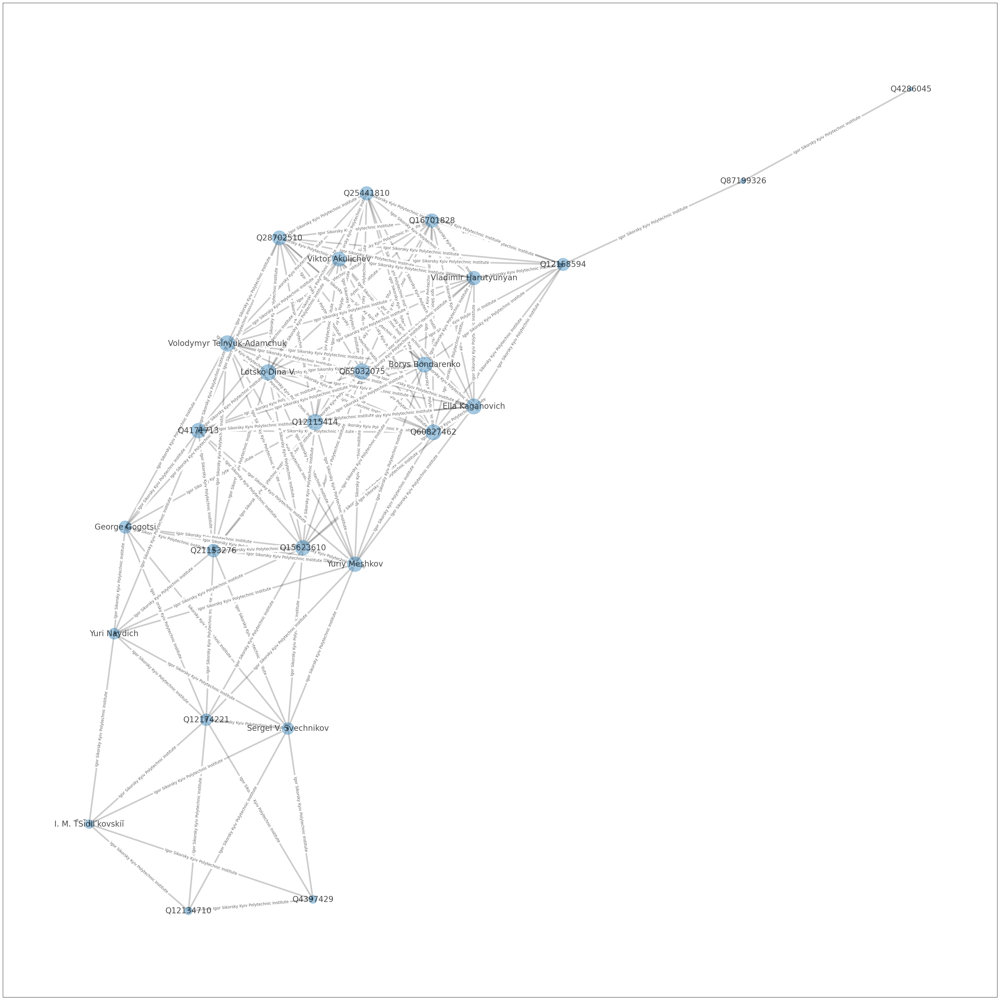

In [ ]:
### 

g = u_117

# print(list(g.nodes.data())[:3])
# print(list(g.edges.data())[:3])

n_size = np.log(np.sqrt(nx.number_of_nodes(g)))* 30 #*25

graph_layout = 'kamada_kawai'
n_k = 0.4
sc = 0.02

### Define the layout, i.e. the choice 
# of the algorithm for the representation of the graph.

if graph_layout == 'fruchterman_reingold':
    pos = nx.fruchterman_reingold_layout(g)
elif graph_layout == 'kamada_kawai':
    pos = nx.kamada_kawai_layout(g)
elif graph_layout == 'spring_layout':
    pos = nx.spring_layout(g, k = n_k, scale=sc)  
else:
    pos = nx.kamada_kawai_layout(g)


# https://networkx.org/documentation/stable/reference/drawing.html
plt.figure(figsize = (n_size,n_size))

node_size = [d[1]*100 for d in nx.degree(g)]
node_labels = dict([tuple(( n[0] , n[1]['label'] ))for n in g.nodes.data()])
print(node_labels)
edge_labels = {e: g.get_edge_data(e[0], e[1])["orgsLabels"] for e in g.edges()}
print(edge_labels)


### On représente successivement les différentes sommets et arêtes,
# puis on ajoute les labels
nx.draw_networkx_nodes(g, pos,  node_size=node_size, alpha=0.4)
nx.draw_networkx_edges(g, pos, label=edge_labels, width=4, alpha=0.2) # edgelist=ln, edge_color=c, 
nx.draw_networkx_labels(g, pos, labels=node_labels, alpha=0.7, font_size=20)
nx.draw_networkx_edge_labels(g, pos=pos, edge_labels=edge_labels, alpha=0.6)

### On peut augmenter ou diminuer ce paramètre pour ajuster le graphe
plt.tight_layout(pad=50)
#plt.savefig('images/small_bipartite_component.svg')
plt.show()


In [366]:
df_p[(df_p.labelOrg.str.contains('Kyiv'))&df_p.relaType.str.contains('educa')].head()

,uriPer,labelPer,birthYear,relaType,uriOrg,labelOrg,nTypes,typesO,periodes,listTypesO,listTokensTypesO,BeginY,EndY,periods
302,http://www.wikidata.org/entity/Q102045640,Yuriy Reznikov,1953,education,http://www.wikidata.org/entity/Q7895611,"University of Kyiv Faculty of Radio Physics, E...",1,university,1941-1960,['university'],['university'],1971.0,1982.0,1941-1960
1616,http://www.wikidata.org/entity/Q104151211,Q104151211,1945,education,http://www.wikidata.org/entity/Q4483619,Faculty of Physics of the Taras Shevchenko Nat...,1,faculty,1941-1960,['faculty'],['faculty'],1963.0,1974.0,1941-1960
1872,http://www.wikidata.org/entity/Q105054057,Yurii B Gaididei,1945,education,http://www.wikidata.org/entity/Q4483619,Faculty of Physics of the Taras Shevchenko Nat...,1,faculty,1941-1960,['faculty'],['faculty'],1963.0,1974.0,1941-1960
3587,http://www.wikidata.org/entity/Q109487886,Viktor L. Afanasyev,1947,education,http://www.wikidata.org/entity/Q84151,Taras Shevchenko National University of Kyiv,4,public university | research university | arch...,1941-1960,"['architectural heritage monument', 'open-acce...","['architectural', 'heritage', 'monument', 'ope...",1965.0,1976.0,1941-1960
3599,http://www.wikidata.org/entity/Q109491581,Viktor Kudryavtsev,1943,education,http://www.wikidata.org/entity/Q84151,Taras Shevchenko National University of Kyiv,4,public university | research university | arch...,1941-1960,"['architectural heritage monument', 'open-acce...","['architectural', 'heritage', 'monument', 'ope...",1961.0,1972.0,1941-1960


#### Composante principale

In [ ]:
li = [0]
U = nx.Graph()
for i in li:
    ## ajoute au graphe les composantes en utilisant
    # l'index ou position dans la liste de graphes 'S'
    U = nx.union(U, S[i])

naf.basic_graph_properties(U)



{'is_multigraph': False,
 'is_directed': False,
 'number_of_nodes': 11098,
 'number_of_edges': 343254,
 '------': '------',
 'is connected': True,
 'components': 1,
 'density': 0.0055743636371697195}


In [ ]:
### Add degree centrality to nodes
degree = dict([(d[0], {'degree': d[1]}) for d in nx.degree(U)])
nx.set_node_attributes(U, degree)
print(list(U.nodes.data())[:3])


[('http://www.wikidata.org/entity/Q1000193', {'label': 'Hans Elsässer', 'birthYear': 1929, 'degree': 14, 'eigenvector': 1.2778588000699235e-05}), ('http://www.wikidata.org/entity/Q100212', {'label': 'Peter Kramer', 'birthYear': 1933, 'degree': 33, 'eigenvector': 1.475192598922754e-05}), ('http://www.wikidata.org/entity/Q102166596', {'label': 'Helmut Fischer', 'birthYear': 1936, 'degree': 17, 'eigenvector': 8.260489807699388e-06})]


In [ ]:
### Add eivenvalue to nodes
eigenvector = nx.eigenvector_centrality(U)
nx.set_node_attributes(U, eigenvector, 'eigenvector')
print(list(U.nodes.data())[:3])

[('http://www.wikidata.org/entity/Q1000193', {'label': 'Hans Elsässer', 'birthYear': 1929, 'degree': 14, 'eigenvector': 1.2750223279194792e-05}), ('http://www.wikidata.org/entity/Q100212', {'label': 'Peter Kramer', 'birthYear': 1933, 'degree': 33, 'eigenvector': 1.1993631832565841e-05}), ('http://www.wikidata.org/entity/Q102166596', {'label': 'Helmut Fischer', 'birthYear': 1936, 'degree': 17, 'eigenvector': 8.19753382812978e-06})]


In [ ]:
### A k-core is a maximal subgraph that contains nodes of degree k or more.
# https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.core.core_number.html#networkx.algorithms.core.core_number
cn = nx.core_number(U)
print(str(cn)[:150])

{'http://www.wikidata.org/entity/Q1000193': 12, 'http://www.wikidata.org/entity/Q100212': 17, 'http://www.wikidata.org/entity/Q102166596': 12, 'http:/


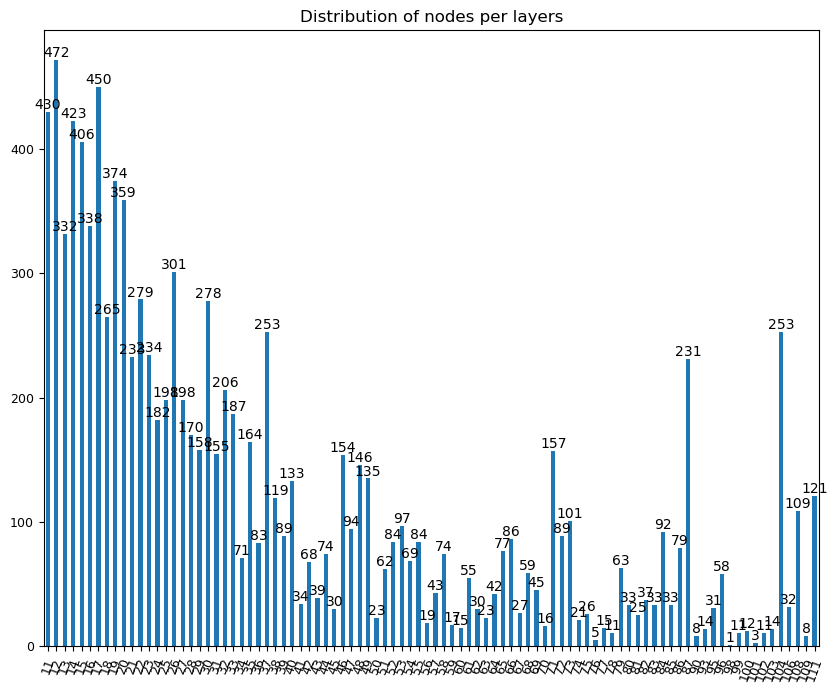

In [ ]:
### Distribution of nodes per layers
l = [v for k,v in cn.items()]
ls = pd.Series(l)
grouped = ls.groupby(ls).size()


ax = grouped.plot.bar(stacked=True, rot=70, fontsize=9, figsize=(10,8))
plt.title('Distribution of nodes per layers')

## https://stackoverflow.com/questions/71320380/add-only-the-total-values-on-top-of-stacked-bars
ax.bar_label(ax.containers[-1])

plt.show()


In [ ]:
ln = [ k  for k,v in cn.items()  if v > 100]
print(len(ln), ln[:3])

551 ['http://www.wikidata.org/entity/Q11191412', 'http://www.wikidata.org/entity/Q114008135', 'http://www.wikidata.org/entity/Q1699823']


In [ ]:
SG = U.subgraph(ln)
naf.basic_graph_properties(SG)


{'is_multigraph': False,
 'is_directed': False,
 'number_of_nodes': 551,
 'number_of_edges': 40923,
 '------': '------',
 'is connected': False,
 'components': 2,
 'density': 0.2700742451740637}


In [ ]:


### Créer à partir des sets de sommets qui forment les components un ensemble de sousgraphes
# Ces ensemble de sous-graphes est stocké dans la liste S
S = [SG.subgraph(c).copy() for c in nx.connected_components(SG)]

### i correspond à la position de la composante dans la liste S, len(s.nodes) à l'effectif des sommets
ln = sorted([[i,len(s.nodes)] for i,s in enumerate(S)], key = lambda row: row[1], reverse=True)
print(ln[:5])



[[0, 409], [1, 142]]


In [ ]:
### 
li = [1]    # [12, 15, 43]
ll = [list(S[i[0]].nodes.data()) for i in ln if i[0] in li ]
#pprint.pprint(str(ll)[:300])

In [ ]:
li = li
liU = nx.Graph()
for i in li:
    ## ajoute au graphe les composantes en utilisant
    # l'index ou position dans la liste de graphes 'S'
    liU = nx.union(liU, S[i])
naf.basic_graph_properties(liU)


{'is_multigraph': False,
 'is_directed': False,
 'number_of_nodes': 142,
 'number_of_edges': 9363,
 '------': '------',
 'is connected': True,
 'components': 1,
 'density': 0.935271201678154}


In [ ]:
print(list(liU.nodes.data())[:3])
print(list(liU.edges.data())[:3])

In [ ]:
### Add betweenness to nodes

# !!! trop long sur tout le graphe SI le graph est grand !!!

betweenness = nx.betweenness_centrality(liU)
nx.set_node_attributes(liU, betweenness, 'betweenness')
print(list(liU.nodes.data())[:3])

[('http://www.wikidata.org/entity/Q43424177', {'label': 'Polina Landa', 'birthYear': 1931, 'degree': 172, 'eigenvector': 0.0002008108496023108, 'betweenness': 0.0007086637422286848}), ('http://www.wikidata.org/entity/Q18123841', {'label': 'Georgy Khristiansen', 'birthYear': 1927, 'degree': 160, 'eigenvector': 0.00018143297611247127, 'betweenness': 0.00040200980899965144}), ('http://www.wikidata.org/entity/Q1995340', {'label': 'Georgy Golitsyn', 'birthYear': 1935, 'degree': 285, 'eigenvector': 0.00025118978697310053, 'betweenness': 0.00035019422328302896})]


[70.86637422286847, 40.200980899965145, 35.019422328302895, 70.86637422286847, 70.86637422286847, 7.908182719438727, 70.86637422286847, 70.86637422286847, 23.7580044667435, 70.86637422286847, 70.86637422286847, 7.967657213680759, 1.4184397163120568, 70.86637422286847, 70.86637422286847, 17.42758188506545, 70.86637422286847, 0.0, 1.4184397163120568, 0.0, 35.019422328302895, 40.200980899965145, 7.967657213680759, 7.908182719438727, 70.86637422286847, 0.0, 70.86637422286847, 61.29439260744771, 70.86637422286847, 70.86637422286847, 70.86637422286847, 70.86637422286847, 70.86637422286847, 40.200980899965145, 1.4184397163120568, 0.0, 0.0, 0.0, 70.86637422286847, 7.967657213680759, 70.86637422286847, 1.4184397163120568, 17.42758188506545, 70.86637422286847, 17.42758188506545, 0.0, 70.86637422286847, 23.7580044667435, 0.0, 70.86637422286847, 70.86637422286847, 7.967657213680759, 70.86637422286847, 70.86637422286847, 17.42758188506545, 70.86637422286847, 70.86637422286847, 70.86637422286847, 35

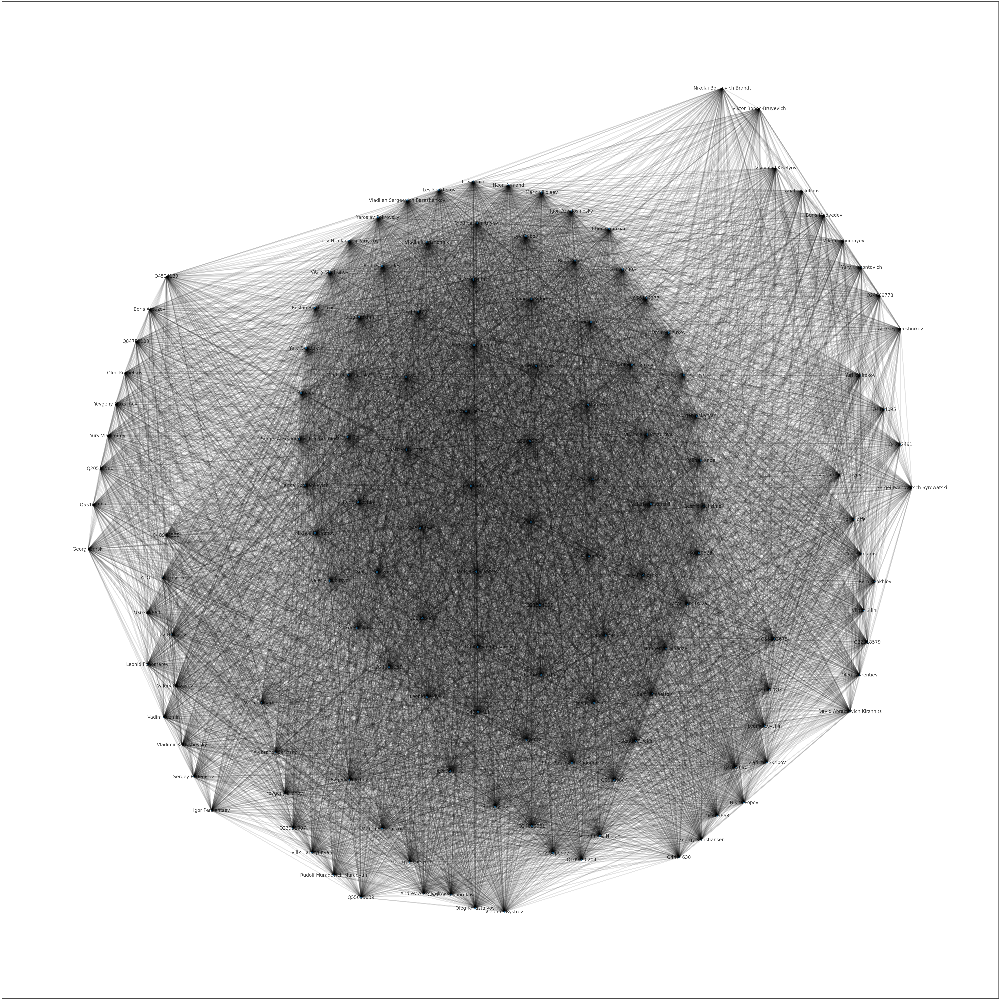

In [ ]:
### 

g = liU

n_size = np.log(np.sqrt(nx.number_of_nodes(g)))* 30 #*25

graph_layout = 'kamada_kawai'
n_k = 0.4
sc = 0.02

### Define the layout, i.e. the choice 
# of the algorithm for the representation of the graph.

if graph_layout == 'fruchterman_reingold':
    pos = nx.fruchterman_reingold_layout(g)
elif graph_layout == 'kamada_kawai':
    pos = nx.kamada_kawai_layout(g)
elif graph_layout == 'spring_layout':
    pos = nx.spring_layout(g, k = n_k, scale=sc)  
else:
    pos = nx.kamada_kawai_layout(g)




# https://networkx.org/documentation/stable/reference/drawing.html
plt.figure(figsize = (n_size,n_size))



## on définit ici l'algorythme avec lequel le traphe sera représenté

#node_size = [d[1]*10 for d in nx.degree(g)]
node_size = [n[1]['betweenness']*100000 for n in g.nodes.data()]
print(node_size)

node_labels = dict([tuple(( n[0] , n[1]['label'] ))for n in g.nodes.data()])
#print(node_labels)
#edge_labels = {e: g.get_edge_data(e[0], e[1])["labelOrg"] for e in g.edges()}
#print(edge_labels)


### On représente successivement les différentes sommets et arêtes,
# puis on ajoute les labels
nx.draw_networkx_nodes(g, pos,  node_size=node_size, alpha=0.6)
nx.draw_networkx_edges(g, pos, label=edge_labels, width=4, alpha=0.1) # edgelist=ln, edge_color=c, 
nx.draw_networkx_labels(g, pos, labels=node_labels, alpha=0.7, font_size=20)
#nx.draw_networkx_edge_labels(g, pos=pos, edge_labels=edge_labels)

### On peut augmenter ou diminuer ce paramètre pour ajuster le graphe
plt.tight_layout(pad=50)
#plt.savefig('images/small_bipartite_component.svg')
plt.show()


In [ ]:
d = [d[1] for d in nx.degree(SG)]
naf.describe_plot_integers_distribution(d, 15,8,'Degree distribution')

In [ ]:
df_sel_o = df_p[['uriPer','uriOrg', 'labelPer', 'relaType', 'periods']].copy(deep=True)
print(len(df_sel_o))
df_sel_o.head()

In [ ]:
merged = pd.merge(df_sel_o, df_sel_o, on=['uriPer', 'labelPer'])
print(len(merged))
merged.head()


In [ ]:
merged = merged[merged['uriPer_x'] < (merged['uriPer_y'])]
print(len(merged))

In [ ]:
merged = merged[(merged['BeginY_y'] < merged['EndY_x']) & (merged['BeginY_x'] < merged['EndY_y'])]
print(len(merged))
print(list(merged.columns))
merged = merged[['uriPer_x', 'uriPer_y', 'uriOrg', 'labelOrg', 'periods_x', 'BeginY_x', 'EndY_x',  'BeginY_y', 'EndY_y', 'periods_y']]



In [ ]:
merged.head()

## Conclusion (provisoire)

* On observe deux types de liens: ceux qui dépendent des publications dans collectifs et actes de colloques et les autres.
  * Il faut définir une méthode pour séparer les deux car ce sont deux logiques différentes
  * On observe aussi des 'passeurs' dont il faudra mieux étudier le profil
* Il y a aussi les liens entre éditeurs et auteurs qui n'ont pas été pris en compte, et qui 
